In [29]:
# imports
import os
import random
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import cv2
import time

from PIL import Image

import torch
import torch.nn as nn
from torch.utils.data import Dataset, DataLoader
import torchvision.transforms as T
import torchvision.utils as vutils

from scipy.linalg import sqrtm
from numpy import cov, trace, iscomplexobj
from numpy import expand_dims, log, mean, std, exp
from math import floor

from keras.applications.inception_v3 import InceptionV3
from keras.applications.inception_v3 import preprocess_input

In [30]:
# ---------------------------
# Reproducibilidad básica
# ---------------------------
SEED = 123
random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed_all(SEED)

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print("Device:", device)

torch.backends.cudnn.benchmark = False
torch.backends.cudnn.deterministic = True

Device: cuda


In [ ]:
class FundusMaskCropPad:
    """
    Preprocesamiento geométrico de la retinografía:
    - Centra el disco de la retina en la imagen
    - Elimina el borde negro exterior y otras zonas de fondo
    - Limpia pequeños agujeros y artefactos de la máscara
    - Recorta la región útil con un bounding box y un pequeño margen
    - Reescala sin deformar y rellena con negro hasta obtener un cuadro size×size
    """
    def __init__(
        self,
        size=256,
        fill=0,
        thr_rgb=15,        
        margin=0.02,
        min_area=5000,     # evitar componentes conectados muy pequeños
        clean_background=False
    ):
        self.size = int(size)
        self.fill = int(fill)
        self.thr_rgb = int(thr_rgb)
        self.margin = float(margin)
        self.min_area = int(min_area)
        self.clean_background = bool(clean_background)

    def __call__(self, img):
        arr = np.array(img)  # RGB uint8
        h, w = arr.shape[:2]

        # 1) máscara "no negro" basada en intensidad máxima
        dist = np.max(arr, axis=2)  # 0..255
        mask = (dist > self.thr_rgb).astype(np.uint8) * 255

        # 2) limpieza morfológica (cerrar agujeros del fundus)
        k = max(3, self.size // 64)
        kernel = np.ones((k, k), np.uint8)
        mask = cv2.morphologyEx(mask, cv2.MORPH_CLOSE, kernel, iterations=3)
        mask = cv2.morphologyEx(mask, cv2.MORPH_OPEN,  kernel, iterations=1)
        mask = cv2.dilate(mask, kernel, iterations=1)

        # 3) componente más grande
        num, labels, stats, _ = cv2.connectedComponentsWithStats(mask, connectivity=8)
        if num <= 1:
            return Image.fromarray(self._letterbox(arr))

        areas = stats[1:, cv2.CC_STAT_AREA]
        idx = 1 + int(np.argmax(areas))
        if stats[idx, cv2.CC_STAT_AREA] < self.min_area:
            return Image.fromarray(self._letterbox(arr))

        comp = (labels == idx).astype(np.uint8)  # 0/1

        # 4) bbox por barrido
        rows = np.where(comp.any(axis=1))[0]
        cols = np.where(comp.any(axis=0))[0]
        if rows.size == 0 or cols.size == 0:
            return Image.fromarray(self._letterbox(arr))

        top, bottom = int(rows[0]), int(rows[-1])
        left, right = int(cols[0]), int(cols[-1])

        mh = int(round((bottom - top + 1) * self.margin))
        mw = int(round((right - left + 1) * self.margin))
        top = max(0, top - mh); bottom = min(h - 1, bottom + mh)
        left = max(0, left - mw); right = min(w - 1, right + mw)

        crop = arr[top:bottom+1, left:right+1]
        comp_crop = comp[top:bottom+1, left:right+1]

        # 5) opcional: limpiar fondo (fuerza negro fuera de comp)
        if self.clean_background:
            crop2 = crop.copy()
            crop2[comp_crop == 0] = self.fill
            crop = crop2

        return Image.fromarray(self._letterbox(crop))

    def _letterbox(self, arr):
        h, w = arr.shape[:2]
        scale = self.size / max(h, w)
        new_w = int(round(w * scale))
        new_h = int(round(h * scale))
        resized = cv2.resize(arr, (new_w, new_h), interpolation=cv2.INTER_AREA)

        out = np.full((self.size, self.size, 3), self.fill, dtype=np.uint8)
        left = (self.size - new_w) // 2
        top  = (self.size - new_h) // 2
        out[top:top+new_h, left:left+new_w] = resized
        return out

In [ ]:
# Dataset de APTOS filtrado a severidad 4, con preprocess FundusMaskCropPad
class AptosDataset(Dataset):
    """
    Dataset APTOS 2019 (Kaggle) basado en train.csv (id_code, diagnosis).

    - Lee el CSV y (opcionalmente) filtra por clases (only_classes=[4]).
    - Carga la imagen desde images_dir/{id_code}.png (o .jpg/.jpeg si existieran).
    - Preprocesamiento por defecto (si no se pasa transform):
        * FundusMaskCropPad: centra la retina y hace letterbox a image_size×image_size
        * Pequeña augmentación geométrica (transformaciones suaves para aumentar la variabilidad sin deformar la retina)
        * Conversión a tensor y normalización a [-1,1] con mean=std=0.5

    Parameters
    ----------
    csv_path : str
        Ruta al archivo CSV (train.csv) con columnas 'id_code' y 'diagnosis'.
    images_dir : str
        Carpeta donde se encuentran las imágenes originales.
    image_size : int
        Tamaño del lado de la imagen de salida (image_size x image_size).
    return_id : bool
        Si es True, __getitem__ devuelve también el id_code.
    only_classes : list[int] | None
        Si se especifica, filtra el dataframe para usar solo esas clases.
    transform : torchvision.transforms.Compose | None
        Transformación completa a aplicar. Si se pasa, sustituye al pipeline por defecto.
    pad_fill : int
        Valor de relleno para el fondo en FundusMaskCropPad.
    """
    def __init__(
        self,
        csv_path,
        images_dir,
        image_size=256,
        return_id=False,
        only_classes=None,
        transform=None,
        pad_fill=0
    ):
        self.csv_path = csv_path
        self.images_dir = images_dir
        self.image_size = int(image_size)
        self.return_id = return_id
        self.only_classes = set(only_classes) if only_classes is not None else None

        self.pad_fill = pad_fill

        df = pd.read_csv(csv_path)
        assert "id_code" in df.columns and "diagnosis" in df.columns

        if self.only_classes is not None:
            df = df[df["diagnosis"].isin(self.only_classes)].reset_index(drop=True)

        self.df = df

        if transform is None:
            # (A) solo preprocesamiento geométrico (fundus + letterbox)
            self.preprocess = FundusMaskCropPad(
                size=self.image_size, fill=0, thr_rgb=15, margin=0.02, clean_background=False
            )

            # (B) augment (solo para entrenamiento)
            self.augment = T.RandomAffine(
                degrees=0, translate=(0.02, 0.02), scale=(0.98, 1.02)
            )

            # (C) tensor + normalize
            self.to_tensor = T.Compose([
                T.ToTensor(),
                T.Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5]),
            ])

            # transform final usado por __getitem__ (train)
            self.transform = T.Compose([
                self.preprocess,
                self.augment,
                self.to_tensor,
            ])
        else:
            self.transform = transform
            self.preprocess = None
            self.augment = None
            self.to_tensor = None


    def _find_image_path(self, id_code):
        for ext in [".png", ".jpg", ".jpeg"]:
            p = os.path.join(self.images_dir, id_code + ext)
            if os.path.exists(p):
                return p
        return None

    def __len__(self):
        return len(self.df)

    def __getitem__(self, idx):
        row = self.df.iloc[idx]
        id_code = row["id_code"]
        label = int(row["diagnosis"])

        img_path = self._find_image_path(id_code)
        if img_path is None:
            raise FileNotFoundError(f"No encontré imagen para id_code={id_code} en {self.images_dir}")

        img = Image.open(img_path).convert("RGB")

        x = self.transform(img)
        y = torch.tensor(label, dtype=torch.long)

        if self.return_id:
            return x, y, id_code
        return x, y

In [33]:
# %% Utils de visualización
def denorm_01(x: torch.Tensor) -> torch.Tensor:
    """
    Convierte tensores normalizados a [-1,1] a [0,1] para poder visualizar con matplotlib.
    """
    return (x * 0.5) + 0.5

def show_before_after(dataset, n=6, seed=123, title="Before/After"):
    """
    Muestra n ejemplos: ORIGINAL vs PREPROCESS vs PREPROCESS+AFFINE (si existe augment).
    No usa DataLoader: trabaja directo con dataset.df/id_code.
    """
    rng = np.random.RandomState(seed)
    idxs = rng.choice(len(dataset), size=min(n, len(dataset)), replace=False)

    cols = 3  # original | preprocess | preprocess+augment
    rows = len(idxs)

    fig, axs = plt.subplots(rows, cols, figsize=(4*cols, 4*rows))
    if rows == 1:
        axs = np.array([axs])

    for r, idx in enumerate(idxs):
        row = dataset.df.iloc[idx]
        id_code = row["id_code"]

        # --- original ---
        img_path = dataset._find_image_path(id_code)
        img0 = Image.open(img_path).convert("RGB")

        axs[r, 0].imshow(img0)
        axs[r, 0].set_title(f"orig\n{id_code}")
        axs[r, 0].axis("off")

        # --- preprocess ---
        if hasattr(dataset, "preprocess") and dataset.preprocess is not None:
            img1 = dataset.preprocess(img0)
        else:
            img1 = img0

        axs[r, 1].imshow(img1)
        axs[r, 1].set_title("preprocess")
        axs[r, 1].axis("off")

        # --- preprocess + augment ---
        if hasattr(dataset, "augment") and dataset.augment is not None:
            img2 = dataset.augment(img1)
        else:
            img2 = img1

        axs[r, 2].imshow(img2)
        axs[r, 2].set_title("pre + affine")
        axs[r, 2].axis("off")

    plt.suptitle(title)
    plt.tight_layout()
    plt.show()

In [ ]:
# Generador DCGAN 256x256 (entrada: ruido z de dimensión NZ)
class Generator(nn.Module):
    """
    Generador DCGAN para imágenes 256x256.
    z: (B, nz, 1, 1) -> x_fake: (B, 3, 256, 256) en [-1,1]
    """
    def __init__(self, nz=256, ngf=64, nc=3):
        super().__init__()
        self.net = nn.Sequential(
            # 1 -> 4
            nn.ConvTranspose2d(nz, ngf * 16, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 16),
            nn.ReLU(True),

            # 4 -> 8
            nn.ConvTranspose2d(ngf * 16, ngf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),

            # 8 -> 16
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),

            # 16 -> 32
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),

            # 32 -> 64
            nn.ConvTranspose2d(ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),

            # 64 -> 128
            nn.ConvTranspose2d(ngf, ngf // 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf // 2),
            nn.ReLU(True),

            # 128 -> 256
            nn.ConvTranspose2d(ngf // 2, nc, 4, 2, 1, bias=False),
            nn.Tanh()
        )

    def forward(self, z):
        return self.net(z)

In [ ]:
# Discriminador DCGAN 256x256 (salida: logit de probabilidad de real)
class Discriminator(nn.Module):
    """
    Discriminador DCGAN para imágenes 256x256.
    x: (B,3,256,256) -> logits: (B,1)
    """
    def __init__(self, ndf=64, nc=3):
        super().__init__()
        self.net = nn.Sequential(
            # 256 -> 128
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),

            # 128 -> 64
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),

            # 64 -> 32
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),

            # 32 -> 16
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),

            # 16 -> 8
            nn.Conv2d(ndf * 8, ndf * 16, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 16),
            nn.LeakyReLU(0.2, inplace=True),

            # 8 -> 4  
            nn.Conv2d(ndf * 16, ndf * 32, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 32),
            nn.LeakyReLU(0.2, inplace=True),

            # 4 -> 1
            nn.Conv2d(ndf * 32, 1, 4, 1, 0, bias=False)
        )

    def forward(self, x):
        logits = self.net(x)         # (B,1,1,1)
        return logits.view(-1, 1)    # (B,1)


In [36]:
def weights_init_dcgan(m):
    """
    Inicialización típica DCGAN:
    - Conv/ConvT: N(0, 0.02)
    - BatchNorm: weight N(1,0.02), bias 0
    """
    classname = m.__class__.__name__
    if classname.find("Conv") != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find("BatchNorm") != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [37]:
# %% Dataset
csv_path = r"C:\Proyecto final\aptos2019-blindness-detection\train.csv"
images_dir = r"C:\Proyecto final\aptos2019-blindness-detection\train_images"

Cantidad imágenes clase 4: 295


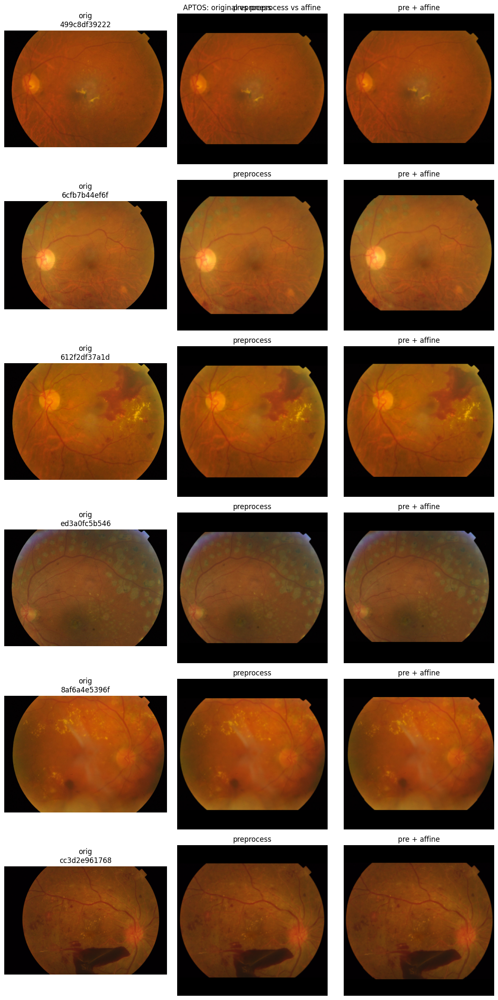

In [38]:
# %% Config entrenamiento

IMG_SIZE = (256, 256)
BATCH_SIZE = 16
NUM_WORKERS = 0

EPOCHS = 100

NZ = 256
LR = 2e-4
BETA1 = 0.5

SAVE_EVERY = 5           # cada cuántas épocas guardamos muestras
CHECKPOINT_DIR = "./checkpoints_dcgan_aptos4"
os.makedirs(CHECKPOINT_DIR, exist_ok=True)

# %% DataLoader SOLO clase 4
dataset_4 = AptosDataset(
    csv_path=csv_path,
    images_dir=images_dir,
    image_size=256,
    pad_fill=0,
    only_classes=[4]
)

loader_4 = DataLoader(
    dataset_4,
    batch_size=BATCH_SIZE,
    shuffle=True,
    num_workers=NUM_WORKERS,
    drop_last=True
)

print("Cantidad imágenes clase 4:", len(dataset_4))
show_before_after(dataset_4, n=6, seed=123, title="APTOS: original vs preprocess vs affine")

In [39]:
img = Image.open(dataset_4._find_image_path(dataset_4.df.iloc[0]["id_code"])).convert("RGB")
print(img.size)  # (W,H)

(3216, 2136)


In [40]:
len(dataset_4.df)

295

In [41]:
dataset_4.df.head(2)

,id_code,diagnosis
0,001639a390f0,4
1,0083ee8054ee,4


In [14]:
# %% Modelos + optimizadores
G = Generator(nz=NZ, ngf=32, nc=3).to(device)
D = Discriminator(ndf=32, nc=3).to(device)

G.apply(weights_init_dcgan)
D.apply(weights_init_dcgan)

criterion = nn.BCEWithLogitsLoss()

optG = torch.optim.Adam(G.parameters(), lr=LR, betas=(BETA1, 0.999))
optD = torch.optim.Adam(D.parameters(), lr=LR, betas=(BETA1, 0.999))

g = torch.Generator(device=device)
g.manual_seed(SEED)
fixed_noise = torch.randn(9, NZ, 1, 1, generator=g, device=device)

C:\Users\karin\AppData\Local\Temp\ipykernel_20244\3397283438.py:6: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scalerD = torch.cuda.amp.GradScaler(enabled=use_amp)
C:\Users\karin\AppData\Local\Temp\ipykernel_20244\3397283438.py:7: FutureWarning: `torch.cuda.amp.GradScaler(args...)` is deprecated. Please use `torch.amp.GradScaler('cuda', args...)` instead.
  scalerG = torch.cuda.amp.GradScaler(enabled=use_amp)


Arrancando desde cero.


C:\Users\karin\AppData\Local\Temp\ipykernel_20244\3397283438.py:123: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=use_amp):
C:\Users\karin\AppData\Local\Temp\ipykernel_20244\3397283438.py:145: FutureWarning: `torch.cuda.amp.autocast(args...)` is deprecated. Please use `torch.amp.autocast('cuda', args...)` instead.
  with torch.cuda.amp.autocast(enabled=use_amp):


Epoch 001/100 | loss_D=1.9349 | loss_G=8.7264


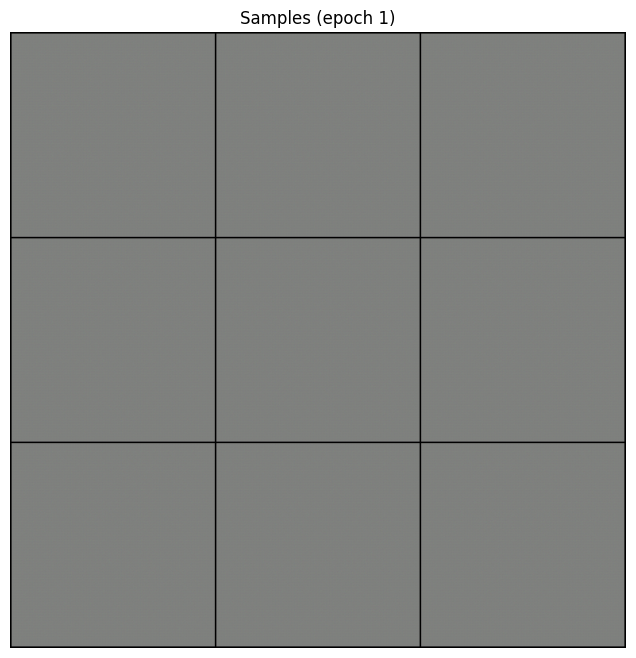

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_001.png


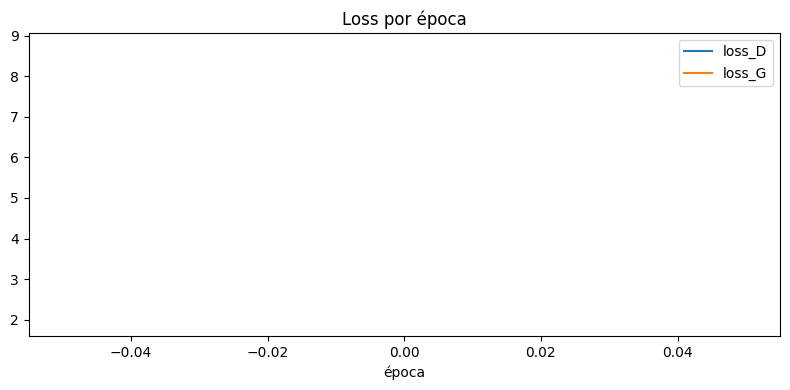

Epoch 002/100 | loss_D=1.6994 | loss_G=15.7831
Epoch 003/100 | loss_D=2.8538 | loss_G=23.5397
Epoch 004/100 | loss_D=1.9745 | loss_G=16.4099
Epoch 005/100 | loss_D=1.1480 | loss_G=9.1008


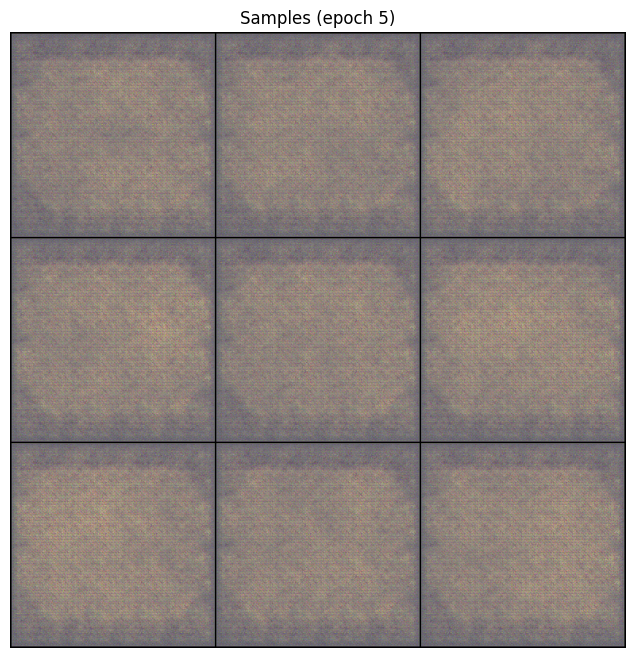

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_005.png


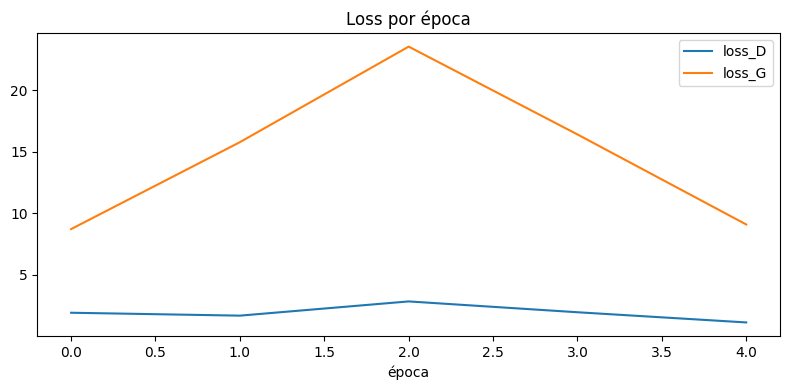

Epoch 006/100 | loss_D=0.7789 | loss_G=6.7720
Epoch 007/100 | loss_D=0.6178 | loss_G=5.3780
Epoch 008/100 | loss_D=1.0190 | loss_G=6.1327
Epoch 009/100 | loss_D=0.6984 | loss_G=5.0063
Epoch 010/100 | loss_D=0.5303 | loss_G=3.8743


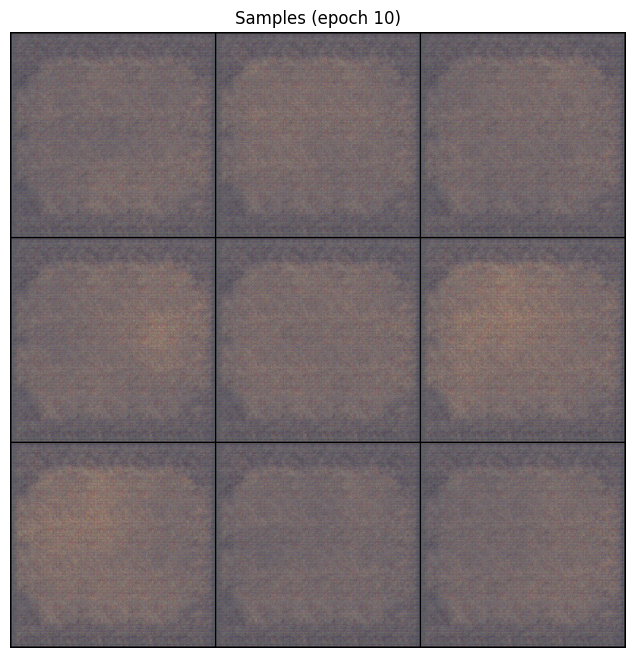

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_010.png


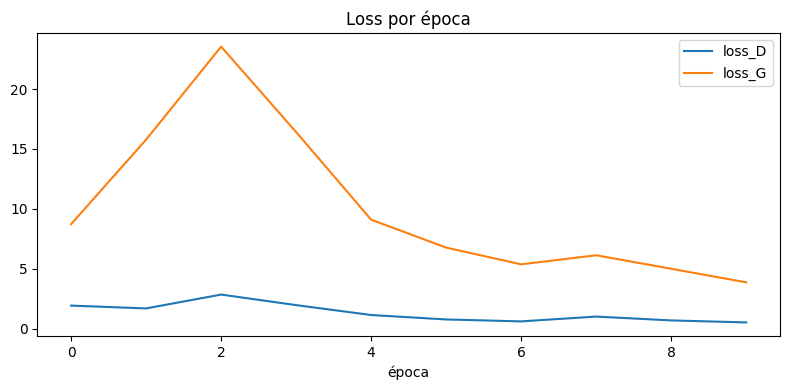

Epoch 011/100 | loss_D=0.6277 | loss_G=4.6965
Epoch 012/100 | loss_D=0.9585 | loss_G=5.4636
Epoch 013/100 | loss_D=0.6099 | loss_G=3.8749
Epoch 014/100 | loss_D=0.7199 | loss_G=5.4126
Epoch 015/100 | loss_D=0.4745 | loss_G=3.5564


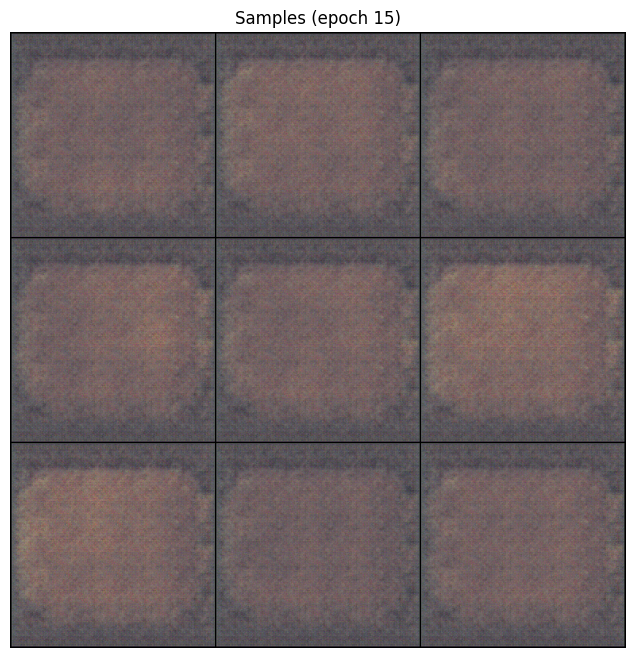

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_015.png


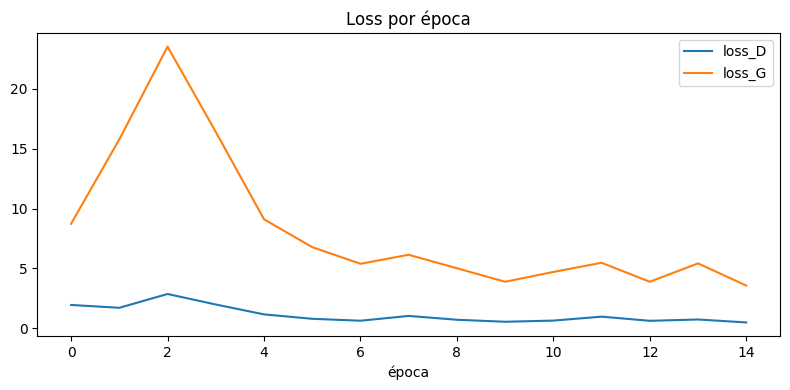

Epoch 016/100 | loss_D=1.0699 | loss_G=4.8654
Epoch 017/100 | loss_D=0.6076 | loss_G=3.9260
Epoch 018/100 | loss_D=0.5664 | loss_G=3.9672
Epoch 019/100 | loss_D=0.7895 | loss_G=5.2150
Epoch 020/100 | loss_D=0.5648 | loss_G=4.1524


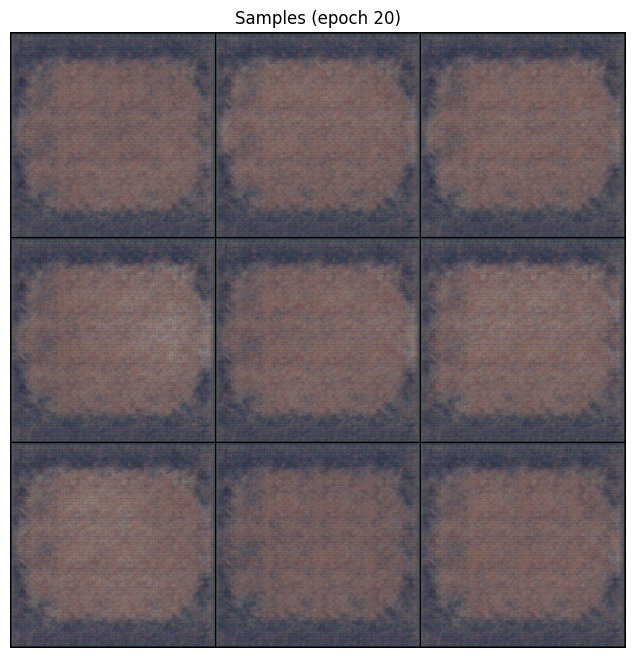

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_020.png


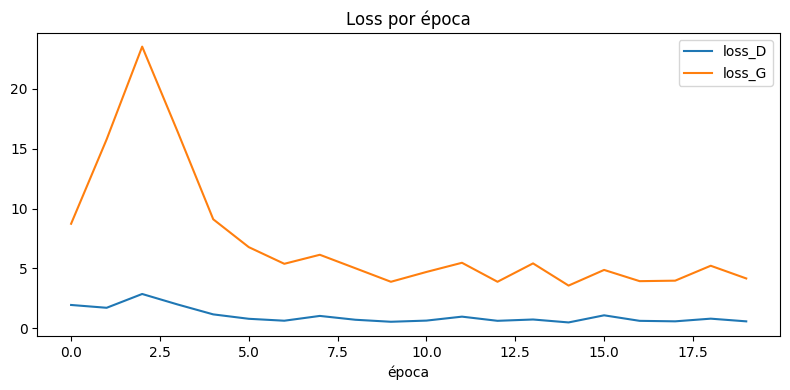

Checkpoint: ./checkpoints_dcgan_aptos4\ckpt_epoch_020.pth
Last: ./checkpoints_dcgan_aptos4\last.pth
Epoch 021/100 | loss_D=1.6040 | loss_G=5.5866
Epoch 022/100 | loss_D=0.5504 | loss_G=3.8620
Epoch 023/100 | loss_D=1.1902 | loss_G=4.8266
Epoch 024/100 | loss_D=0.6227 | loss_G=3.7906
Epoch 025/100 | loss_D=0.5876 | loss_G=3.8280


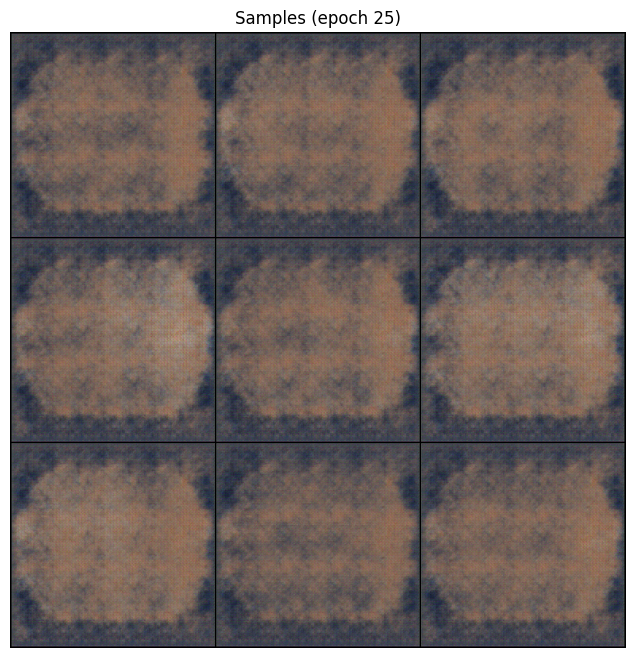

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_025.png


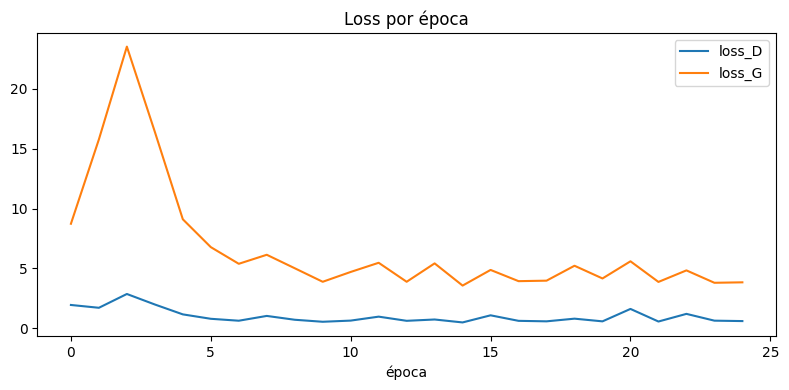

Epoch 026/100 | loss_D=0.5256 | loss_G=3.7052
Epoch 027/100 | loss_D=0.6370 | loss_G=4.0420
Epoch 028/100 | loss_D=0.5279 | loss_G=4.0821
Epoch 029/100 | loss_D=0.4965 | loss_G=3.8405
Epoch 030/100 | loss_D=0.6808 | loss_G=4.5185


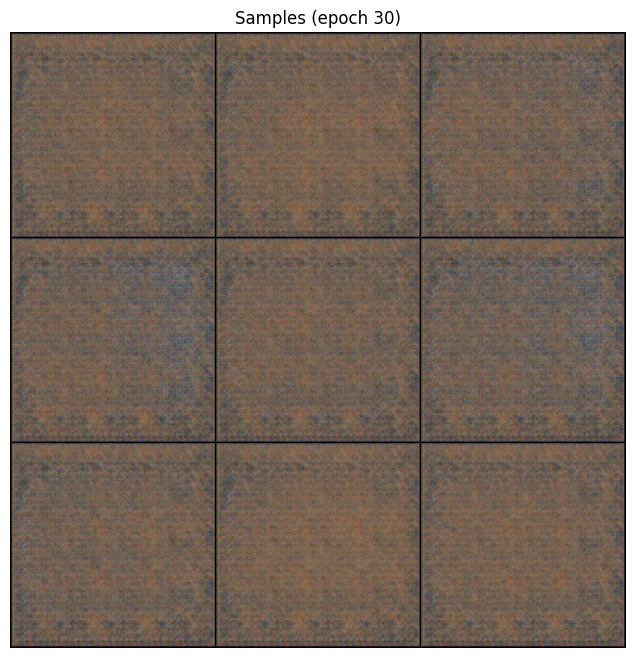

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_030.png


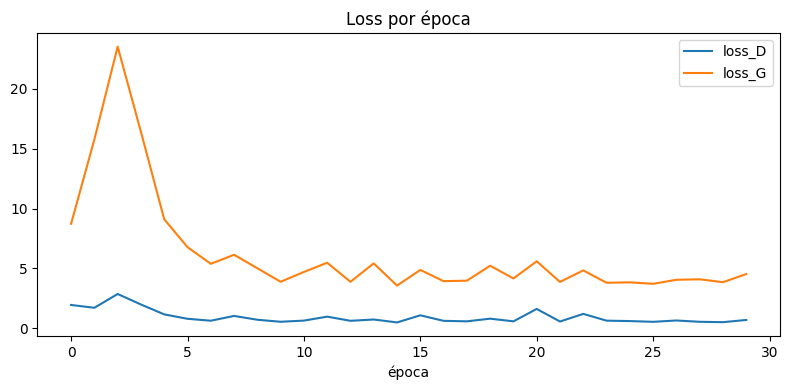

Epoch 031/100 | loss_D=0.7682 | loss_G=4.5706
Epoch 032/100 | loss_D=0.4680 | loss_G=3.3221
Epoch 033/100 | loss_D=0.7233 | loss_G=4.1936
Epoch 034/100 | loss_D=0.7638 | loss_G=4.1915
Epoch 035/100 | loss_D=0.5433 | loss_G=3.6885


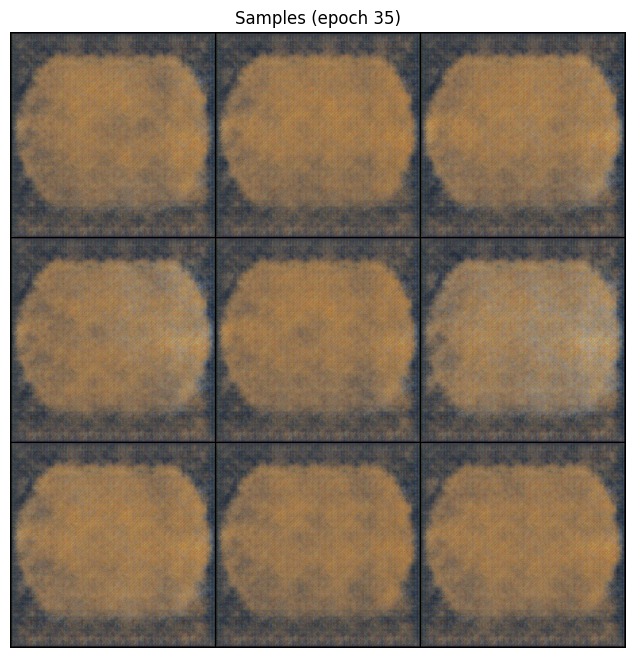

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_035.png


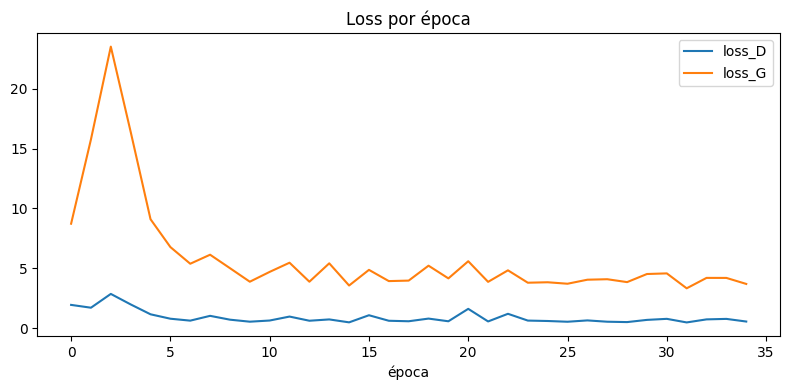

Epoch 036/100 | loss_D=0.6555 | loss_G=3.7683
Epoch 037/100 | loss_D=0.7476 | loss_G=3.8485
Epoch 038/100 | loss_D=0.8231 | loss_G=4.1455
Epoch 039/100 | loss_D=0.5491 | loss_G=3.3028
Epoch 040/100 | loss_D=0.5730 | loss_G=3.8016


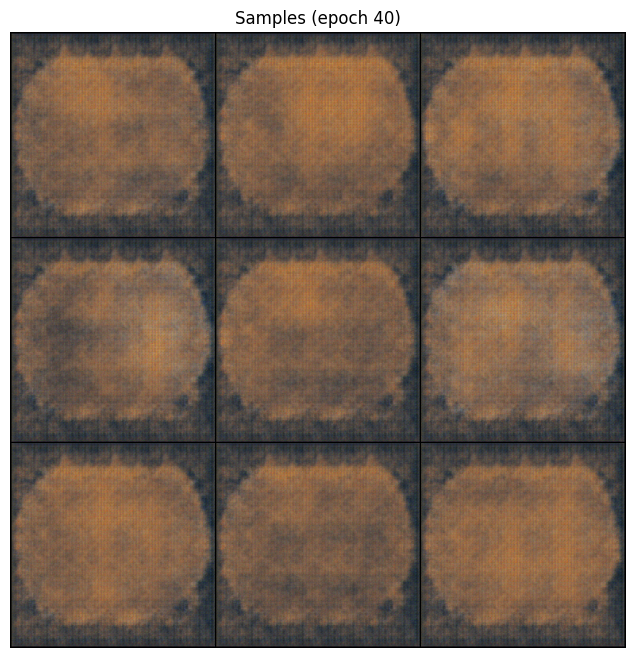

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_040.png


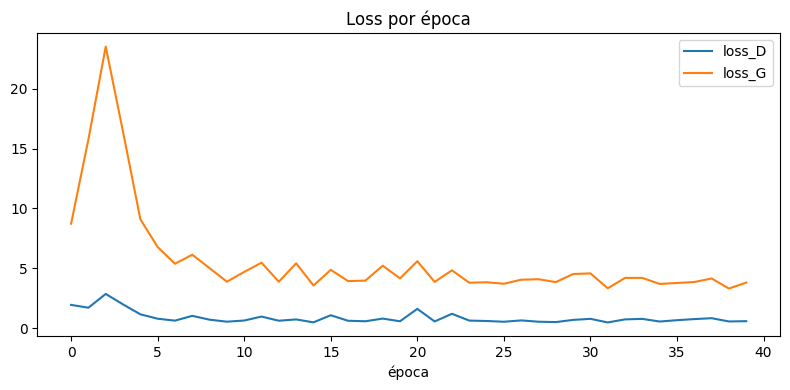

Checkpoint: ./checkpoints_dcgan_aptos4\ckpt_epoch_040.pth
Last: ./checkpoints_dcgan_aptos4\last.pth
Epoch 041/100 | loss_D=1.1258 | loss_G=3.5619
Epoch 042/100 | loss_D=0.5963 | loss_G=3.7897
Epoch 043/100 | loss_D=0.6253 | loss_G=3.5203
Epoch 044/100 | loss_D=0.5131 | loss_G=3.7520
Epoch 045/100 | loss_D=0.9623 | loss_G=4.1745


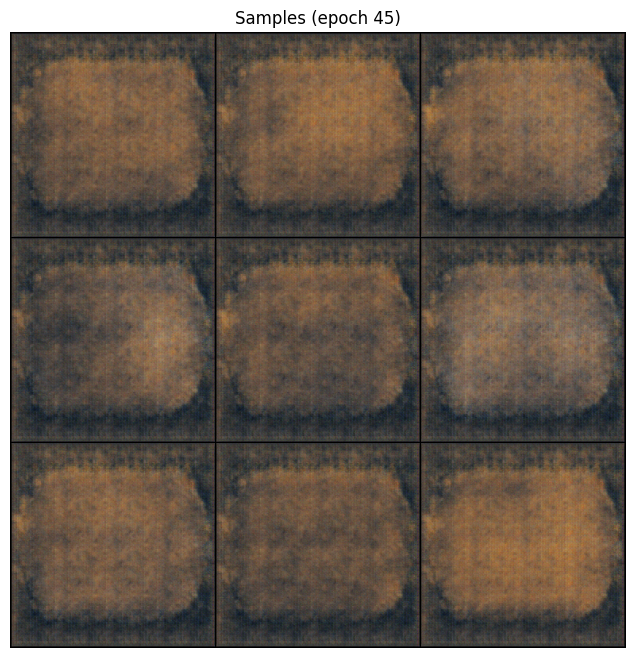

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_045.png


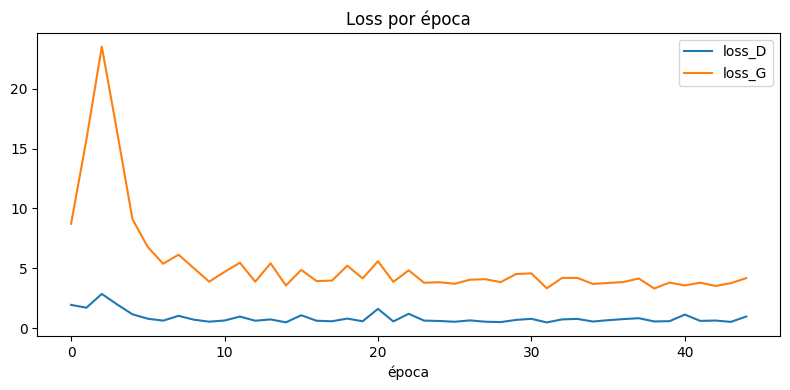

Epoch 046/100 | loss_D=0.5770 | loss_G=3.4513
Epoch 047/100 | loss_D=0.6009 | loss_G=3.8913
Epoch 048/100 | loss_D=0.6647 | loss_G=3.5027
Epoch 049/100 | loss_D=0.6410 | loss_G=3.9053
Epoch 050/100 | loss_D=0.6534 | loss_G=3.8134


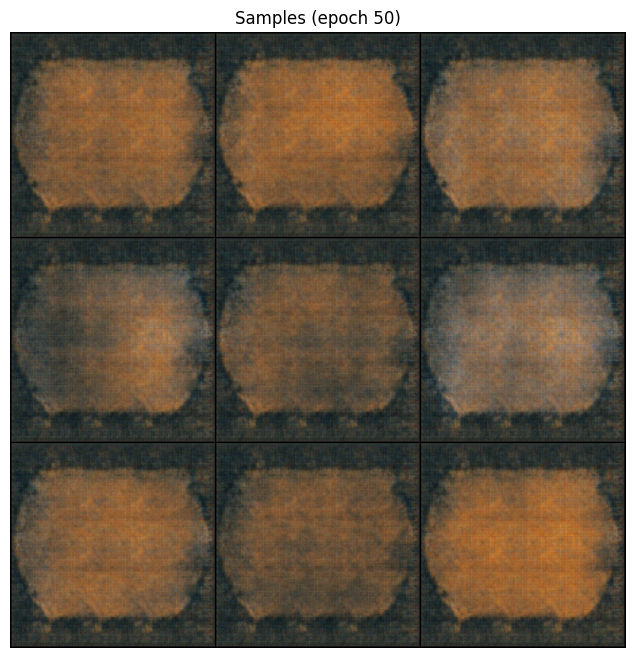

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_050.png


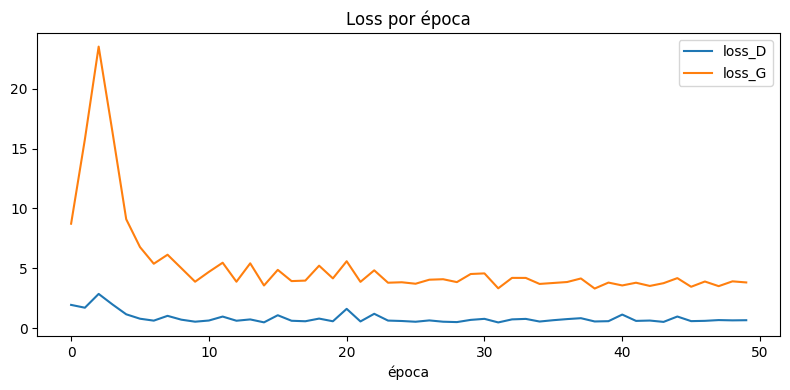

Epoch 051/100 | loss_D=0.6958 | loss_G=3.5262
Epoch 052/100 | loss_D=0.5660 | loss_G=3.3864
Epoch 053/100 | loss_D=0.7541 | loss_G=3.5522
Epoch 054/100 | loss_D=0.7254 | loss_G=4.4996
Epoch 055/100 | loss_D=0.6086 | loss_G=3.7307


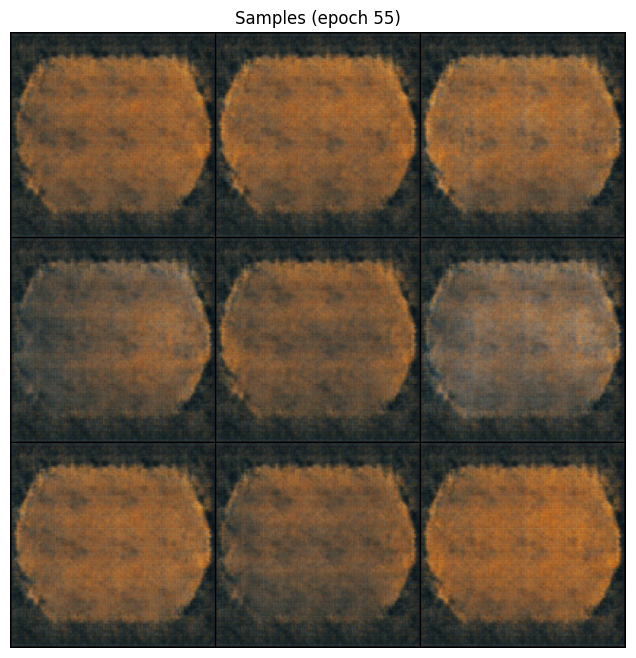

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_055.png


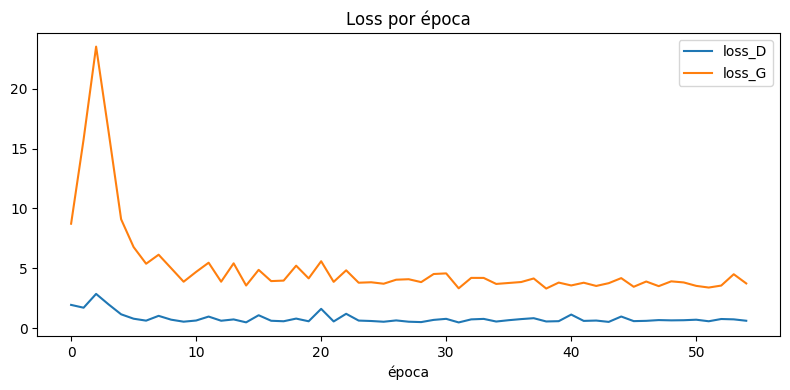

Epoch 056/100 | loss_D=0.7266 | loss_G=3.9518
Epoch 057/100 | loss_D=0.5582 | loss_G=3.7424
Epoch 058/100 | loss_D=0.5120 | loss_G=3.7804
Epoch 059/100 | loss_D=0.5445 | loss_G=5.3245
Epoch 060/100 | loss_D=0.4983 | loss_G=4.0472


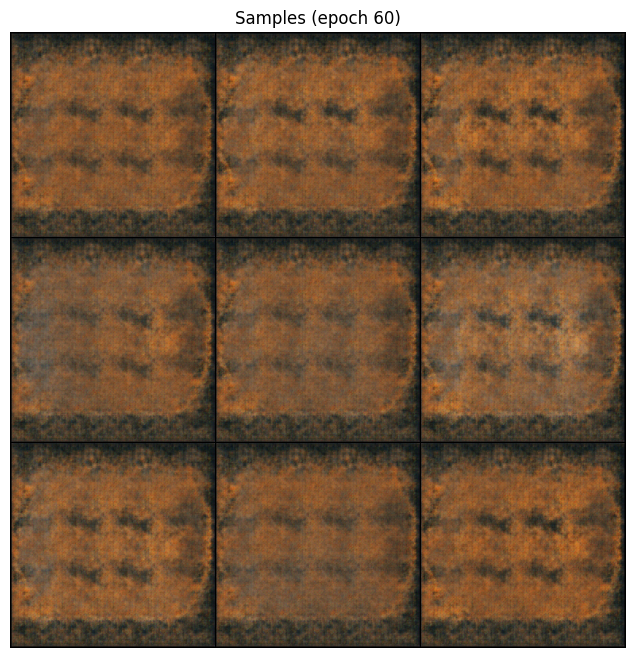

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_060.png


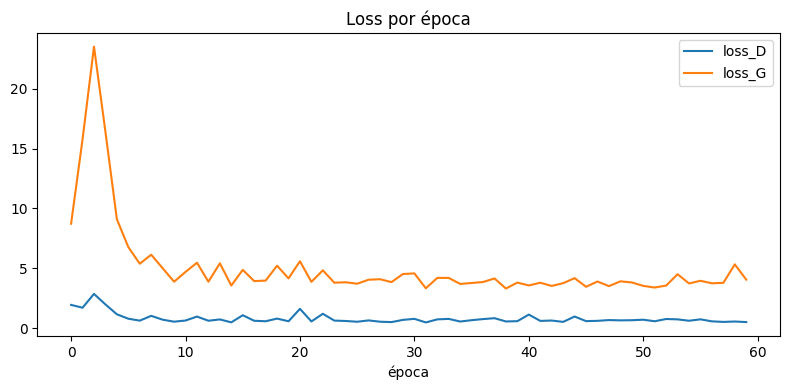

Checkpoint: ./checkpoints_dcgan_aptos4\ckpt_epoch_060.pth
Last: ./checkpoints_dcgan_aptos4\last.pth
Epoch 061/100 | loss_D=0.7356 | loss_G=3.8805
Epoch 062/100 | loss_D=0.8510 | loss_G=3.9940
Epoch 063/100 | loss_D=0.7129 | loss_G=3.9070
Epoch 064/100 | loss_D=0.7251 | loss_G=4.0940
Epoch 065/100 | loss_D=0.9361 | loss_G=4.0489


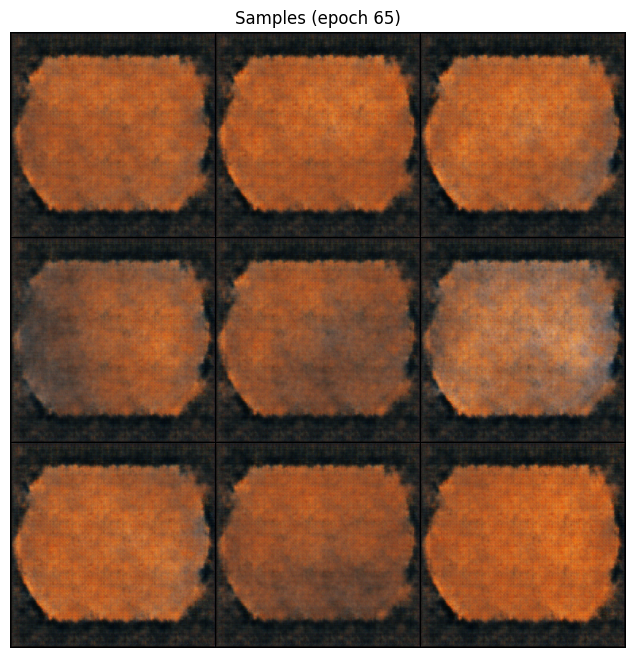

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_065.png


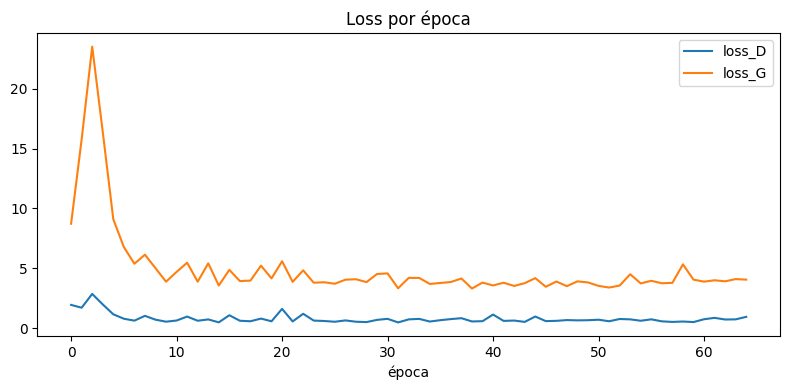

Epoch 066/100 | loss_D=0.5871 | loss_G=3.2774
Epoch 067/100 | loss_D=0.5345 | loss_G=3.5030
Epoch 068/100 | loss_D=0.6040 | loss_G=4.2809
Epoch 069/100 | loss_D=0.6021 | loss_G=3.5760
Epoch 070/100 | loss_D=0.8522 | loss_G=3.7365


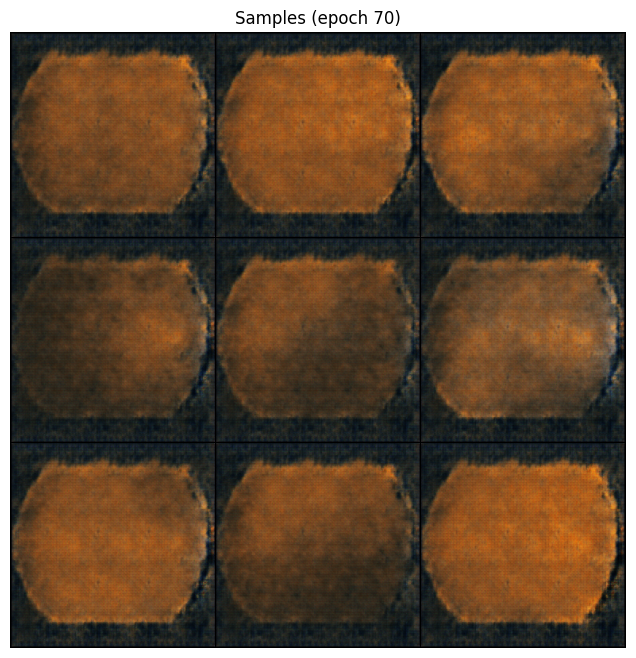

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_070.png


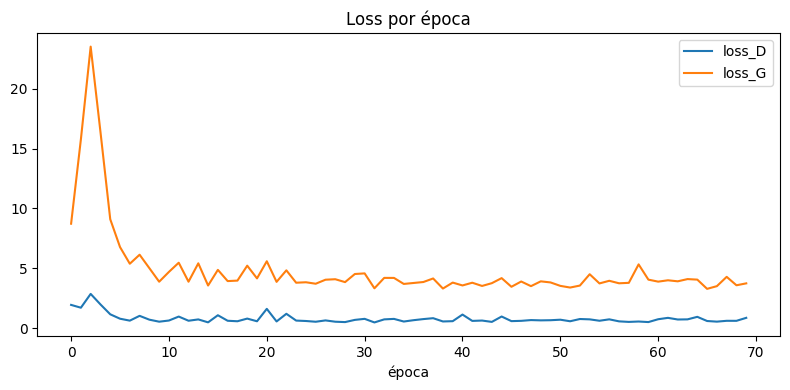

Epoch 071/100 | loss_D=0.7825 | loss_G=4.4332
Epoch 072/100 | loss_D=0.5769 | loss_G=3.4719
Epoch 073/100 | loss_D=0.7092 | loss_G=3.6346
Epoch 074/100 | loss_D=0.5408 | loss_G=3.3683
Epoch 075/100 | loss_D=1.0224 | loss_G=4.3517


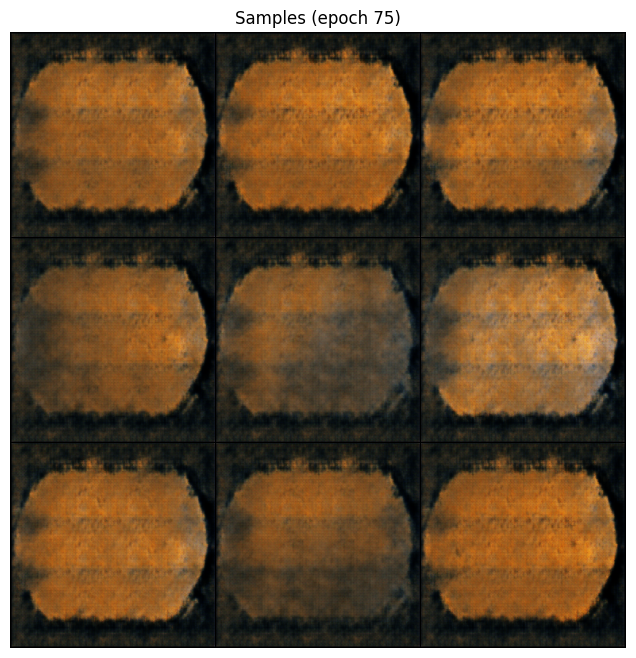

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_075.png


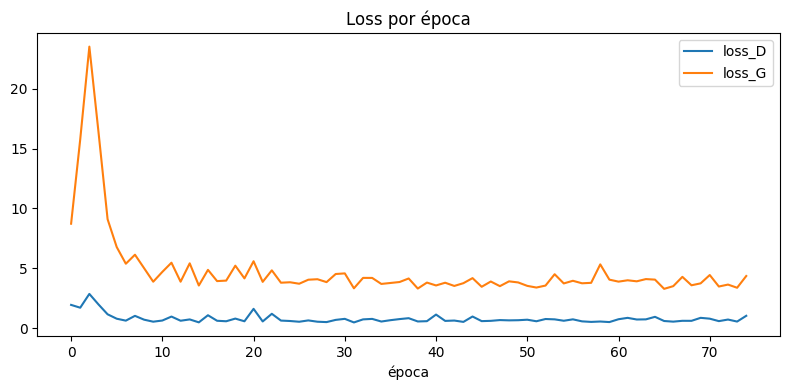

Epoch 076/100 | loss_D=0.6184 | loss_G=3.2282
Epoch 077/100 | loss_D=0.6840 | loss_G=4.0168
Epoch 078/100 | loss_D=0.5207 | loss_G=3.5766
Epoch 079/100 | loss_D=0.5456 | loss_G=3.2371
Epoch 080/100 | loss_D=0.7222 | loss_G=4.0090


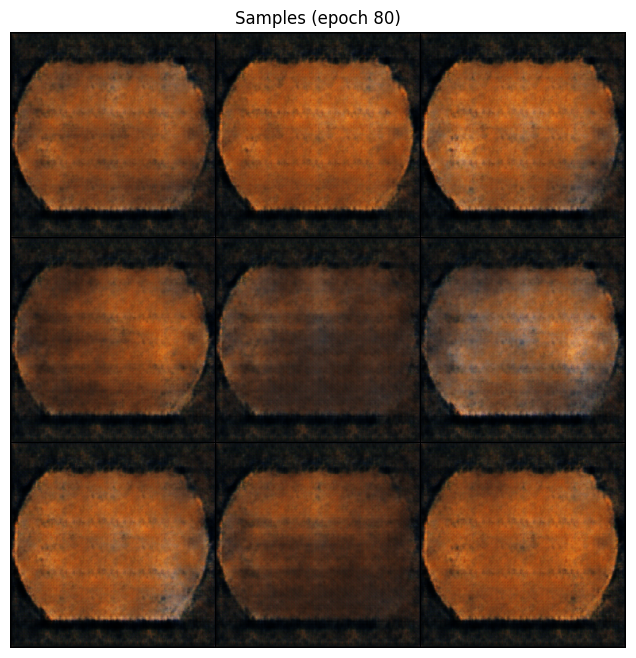

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_080.png


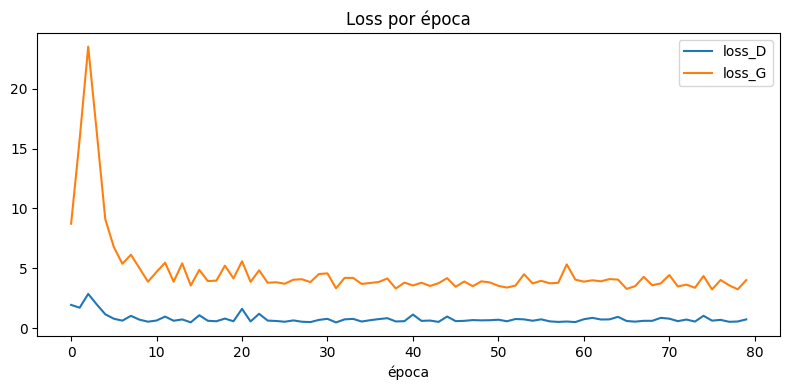

Checkpoint: ./checkpoints_dcgan_aptos4\ckpt_epoch_080.pth
Last: ./checkpoints_dcgan_aptos4\last.pth
Epoch 081/100 | loss_D=0.5785 | loss_G=3.6993
Epoch 082/100 | loss_D=0.7564 | loss_G=3.9883
Epoch 083/100 | loss_D=0.5349 | loss_G=3.4515
Epoch 084/100 | loss_D=0.6797 | loss_G=3.6908
Epoch 085/100 | loss_D=0.6706 | loss_G=3.9202


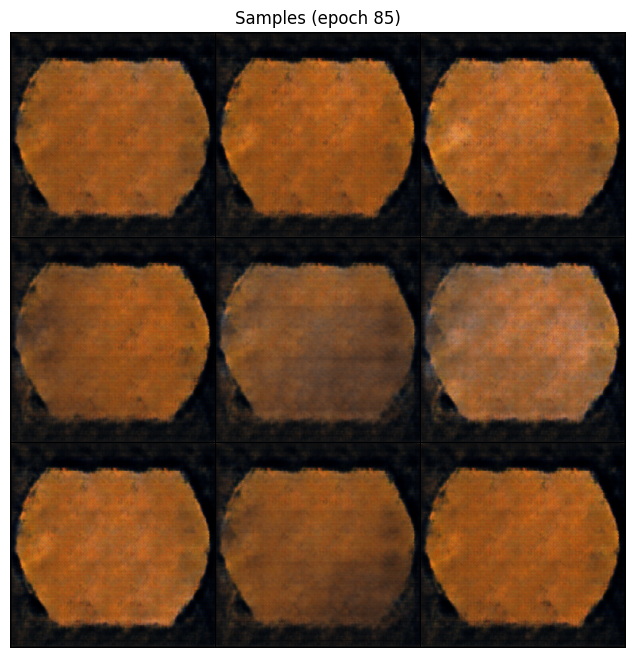

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_085.png


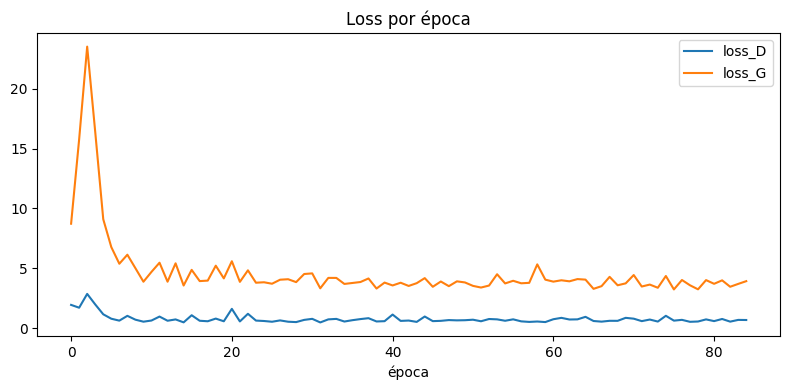

Epoch 086/100 | loss_D=0.5608 | loss_G=3.4485
Epoch 087/100 | loss_D=0.7000 | loss_G=4.0967
Epoch 088/100 | loss_D=0.5817 | loss_G=3.9524
Epoch 089/100 | loss_D=0.5418 | loss_G=3.3969
Epoch 090/100 | loss_D=0.6791 | loss_G=4.4976


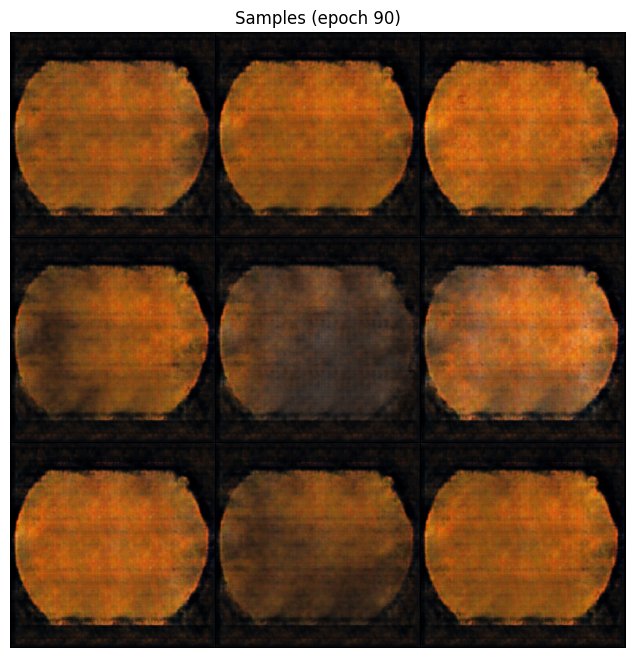

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_090.png


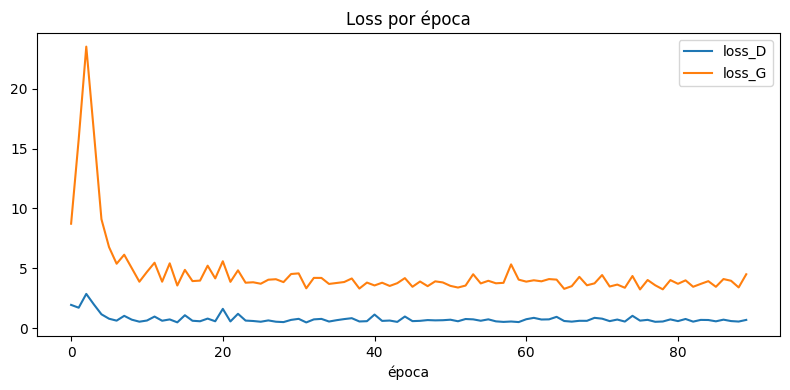

Epoch 091/100 | loss_D=0.5384 | loss_G=3.3737
Epoch 092/100 | loss_D=0.5188 | loss_G=3.5470
Epoch 093/100 | loss_D=0.5327 | loss_G=3.7382
Epoch 094/100 | loss_D=0.6937 | loss_G=4.8048
Epoch 095/100 | loss_D=0.6668 | loss_G=3.9307


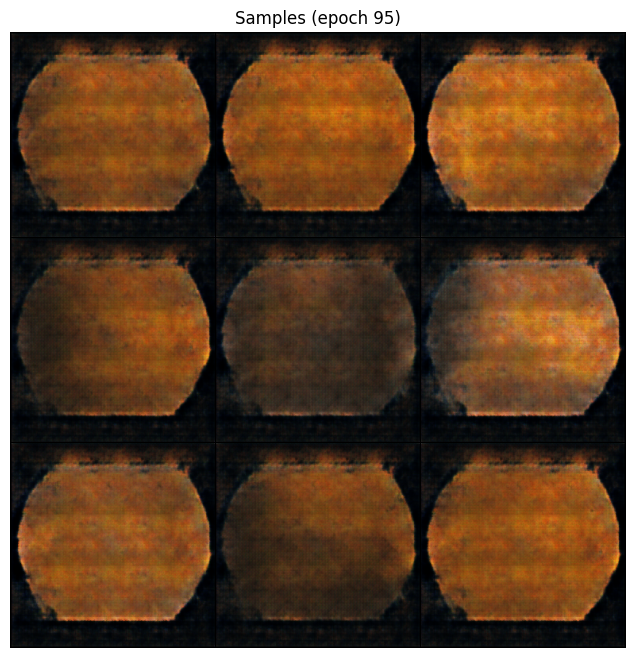

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_095.png


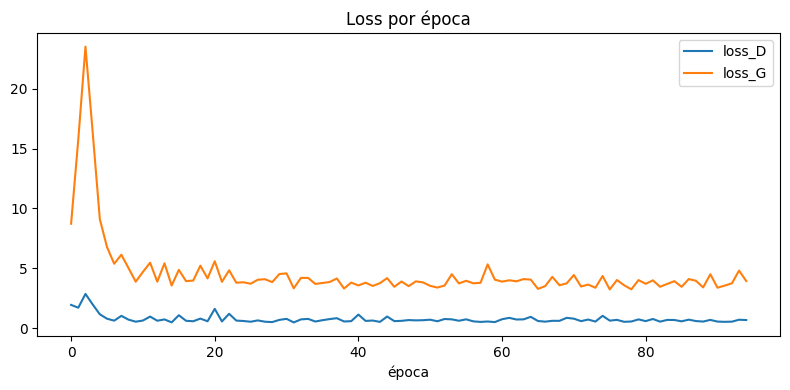

Epoch 096/100 | loss_D=0.7104 | loss_G=3.9205
Epoch 097/100 | loss_D=0.5823 | loss_G=3.6378
Epoch 098/100 | loss_D=0.6476 | loss_G=3.8117
Epoch 099/100 | loss_D=0.4857 | loss_G=3.2341
Epoch 100/100 | loss_D=0.4625 | loss_G=3.7519


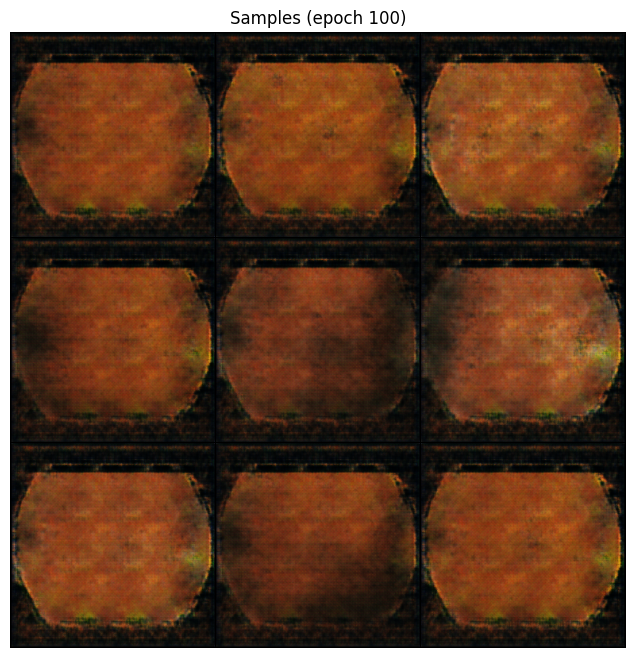

Saved: ./checkpoints_dcgan_aptos4\samples_epoch_100.png


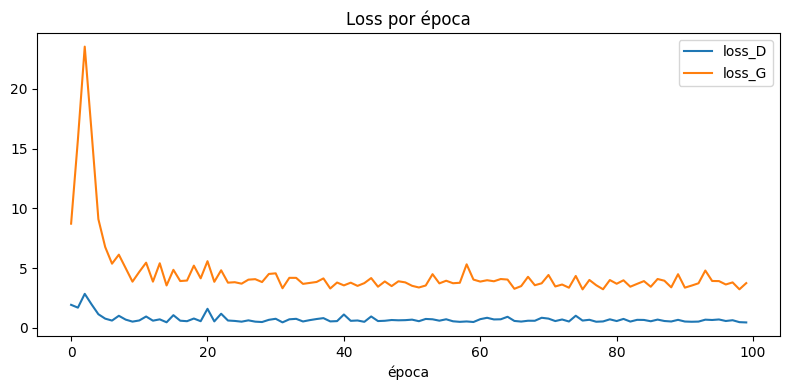

Checkpoint: ./checkpoints_dcgan_aptos4\ckpt_epoch_100.pth
Last: ./checkpoints_dcgan_aptos4\last.pth
Checkpoint: ./checkpoints_dcgan_aptos4\ckpt_epoch_100.pth
Last: ./checkpoints_dcgan_aptos4\last.pth
Fin entrenamiento.
Tiempo total (seg): 12570.070263624191


In [ ]:
# %% Entrenamiento (con AMP / mixed precision)  +  RESUME + "last.pth"
history = {"loss_D": [], "loss_G": []}

# --- AMP setup (definido una sola vez antes del loop de entrenamiento) ---
use_amp = (device.type == "cuda")
scalerD = torch.cuda.amp.GradScaler(enabled=use_amp)
scalerG = torch.cuda.amp.GradScaler(enabled=use_amp)

# -------------------------
# RESUME (reanudar) opcional
# -------------------------
RESUME = True
RESUME_PATH = os.path.join(CHECKPOINT_DIR, "last.pth")  # o un ckpt_epoch_XXX.pth
start_epoch = 1

if RESUME and os.path.exists(RESUME_PATH):
    ckpt = torch.load(RESUME_PATH, map_location=device)

    G.load_state_dict(ckpt["G_state"])
    D.load_state_dict(ckpt["D_state"])
    optG.load_state_dict(ckpt["optG_state"])
    optD.load_state_dict(ckpt["optD_state"])

    # historial (si existe)
    history = ckpt.get("history", history)

    # AMP scalers (si existen en ckpt)
    if "scalerD_state" in ckpt:
        scalerD.load_state_dict(ckpt["scalerD_state"])
    if "scalerG_state" in ckpt:
        scalerG.load_state_dict(ckpt["scalerG_state"])

    start_epoch = int(ckpt["epoch"]) + 1
    print(f"Resumiendo desde epoch {start_epoch} (cargado: {RESUME_PATH})")
else:
    print("Arrancando desde cero.")

# -------------------------
# SAVE helpers
# -------------------------
SAVE_SAMPLES_EVERY = 5   # grillas
SAVE_CKPT_EVERY    = 20  # checkpoints (más espaciado que samples)

def save_samples(epoch, G, fixed_noise, out_dir):
    """
    Genera 9 muestras con un ruido fijo para comparar progreso entre épocas.
    Guarda un PNG y también lo muestra.
    """
    G.eval()
    with torch.no_grad():
        fake = G(fixed_noise).detach().cpu()
    G.train()

    # [-1,1] -> [0,1]
    fake = denorm_01(fake).clamp(0, 1)

    # Grid 3x3
    grid = vutils.make_grid(fake, nrow=3)

    plt.figure(figsize=(8, 8))
    plt.imshow(grid.permute(1, 2, 0))
    plt.axis("off")
    plt.title(f"Samples (epoch {epoch})")

    path = os.path.join(out_dir, f"samples_epoch_{epoch:03d}.png")
    plt.savefig(path, dpi=150, bbox_inches="tight")
    plt.show()
    plt.close()
    print("Saved:", path)

def save_checkpoint(epoch, out_dir, is_last=True):
    """
    Guarda:
    - ckpt_epoch_XXX.pth (cada SAVE_CKPT_EVERY)
    - last.pth (siempre que se llame con is_last=True)
    """
    ckpt = {
        "epoch": epoch,
        "G_state": G.state_dict(),
        "D_state": D.state_dict(),
        "optG_state": optG.state_dict(),
        "optD_state": optD.state_dict(),
        "history": history,
        "img_size": IMG_SIZE,
        "nz": NZ,
        # AMP scalers (para reanudar estable)
        "scalerD_state": scalerD.state_dict(),
        "scalerG_state": scalerG.state_dict(),
    }

    # checkpoint por epoch
    ckpt_path = os.path.join(out_dir, f"ckpt_epoch_{epoch:03d}.pth")
    torch.save(ckpt, ckpt_path)
    print("Checkpoint:", ckpt_path)

    # checkpoint "last" (sobrescribe)
    if is_last:
        last_path = os.path.join(out_dir, "last.pth")
        torch.save(ckpt, last_path)
        print("Last:", last_path)

# -------------------------
# TRAIN LOOP
# -------------------------
t0 = time.time()

for epoch in range(start_epoch, EPOCHS + 1):
    lossD_epoch = 0.0
    lossG_epoch = 0.0

    for X_real, _ in loader_4:
        X_real = X_real.to(device)

        # -----------------------
        # (1) Train Discriminator (AMP)
        # -----------------------
        optD.zero_grad(set_to_none=True)

        bsz = X_real.size(0)
        real_targets = torch.empty(bsz, 1, device=device).uniform_(0.9, 1.0)
        fake_targets = torch.empty(bsz, 1, device=device).uniform_(0.0, 0.1)

        with torch.cuda.amp.autocast(enabled=use_amp):
            # real
            logits_real = D(X_real)
            loss_real = criterion(logits_real, real_targets)

            # fake
            z = torch.randn(bsz, NZ, 1, 1, device=device)
            X_fake = G(z)
            logits_fake = D(X_fake.detach())
            loss_fake = criterion(logits_fake, fake_targets)

            loss_D = loss_real + loss_fake

        scalerD.scale(loss_D).backward()
        scalerD.step(optD)
        scalerD.update()

        # -------------------
        # (2) Train Generator (AMP)
        # -------------------
        optG.zero_grad(set_to_none=True)

        with torch.cuda.amp.autocast(enabled=use_amp):
            logits_fake_for_G = D(X_fake)  # reusa X_fake del paso anterior
            loss_G = criterion(logits_fake_for_G, real_targets)

        scalerG.scale(loss_G).backward()
        scalerG.step(optG)
        scalerG.update()

        lossD_epoch += loss_D.item()
        lossG_epoch += loss_G.item()

    lossD_epoch /= len(loader_4)
    lossG_epoch /= len(loader_4)
    history["loss_D"].append(lossD_epoch)
    history["loss_G"].append(lossG_epoch)

    print(f"Epoch {epoch:03d}/{EPOCHS} | loss_D={lossD_epoch:.4f} | loss_G={lossG_epoch:.4f}")

    # -------------------------
    # Samples + loss curve
    # -------------------------
    if epoch % SAVE_SAMPLES_EVERY == 0 or epoch == start_epoch:
        save_samples(epoch, G, fixed_noise, CHECKPOINT_DIR)

        plt.figure(figsize=(8, 4))
        plt.plot(history["loss_D"], label="loss_D")
        plt.plot(history["loss_G"], label="loss_G")
        plt.title("Loss por época")
        plt.xlabel("época")
        plt.legend()
        plt.tight_layout()
        plt.show()
        plt.close()

    # -------------------------
    # Checkpoints
    # -------------------------
    # (a) cada SAVE_CKPT_EVERY: ckpt_epoch_XXX + last.pth
    if epoch % SAVE_CKPT_EVERY == 0:
        save_checkpoint(epoch, CHECKPOINT_DIR, is_last=True)

    # (b) al final: siempre guarda last.pth y el epoch final
    if epoch == EPOCHS:
        save_checkpoint(epoch, CHECKPOINT_DIR, is_last=True)

t1 = time.time()
print("Fin entrenamiento.")
print("Tiempo total (seg):", t1 - t0)

In [16]:
print("Tiempo 1 época (seg):", t1 - t0)
print("Estimación 100 épocas (min):", (t1 - t0) * 100 / 60)

Tiempo 1 época (seg): 12570.070263624191
Estimación 100 épocas (min): 20950.117106040318


# Inferencia

In [ ]:
def load_dcgan_generator(ckpt_path, nz=256, ngf=32, nc=3, device="cuda"):
    G = Generator(nz=nz, ngf=ngf, nc=nc).to(device)
    ckpt = torch.load(ckpt_path, map_location=device)

    # El checkpoint guarda un diccionario con la clave "G_state"
    if isinstance(ckpt, dict) and "G_state" in ckpt:
        G.load_state_dict(ckpt["G_state"])
    else:
        # por si alguna vez guardás el state_dict directo
        G.load_state_dict(ckpt)

    G.eval()
    return G

@torch.no_grad()
# Genera muestras falsas con un generador entrenado a partir de ruido z
def sample_dcgan(G, nz=256, n=16, device="cuda"):
    z = torch.randn(n, nz, 1, 1, device=device)
    fake = G(z).detach().cpu()            # (n,3,256,256) en [-1,1]
    fake01 = ((fake + 1) / 2).clamp(0, 1) # a [0,1] para ver/guardar
    return fake01

def show_grid_01(imgs01, nrow=4, title=""):
    grid = vutils.make_grid(imgs01, nrow=nrow, padding=2)
    plt.figure(figsize=(8, 8))
    plt.imshow(grid.permute(1, 2, 0))
    plt.axis("off")
    plt.title(title)
    plt.show()
    plt.close()

C:\Users\karin\AppData\Local\Temp\ipykernel_20244\4139110.py:3: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  ckpt = torch.load(ckpt_path, map_location=device)


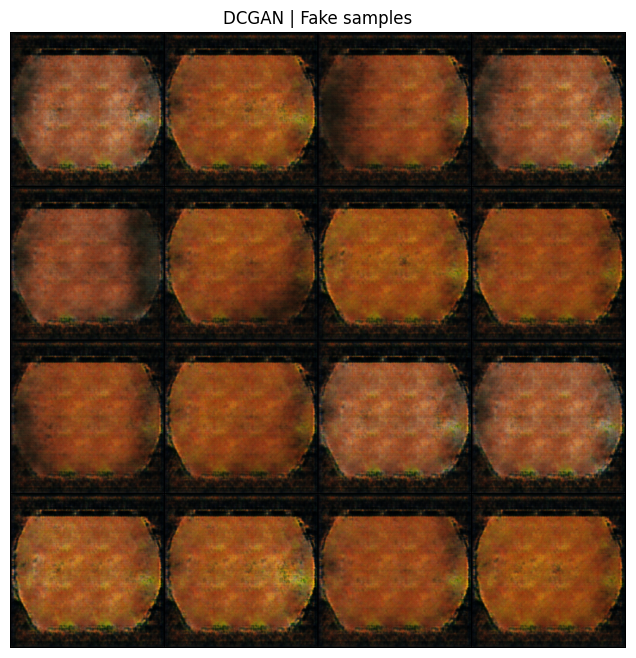

Saved: ./checkpoints_dcgan_aptos4\inference_grid.png


In [18]:
# --- Carga de checkpoints ------
CKPT_TO_LOAD = os.path.join(CHECKPOINT_DIR, "best.pth")  
generator = load_dcgan_generator(CKPT_TO_LOAD, nz=NZ, ngf=32, nc=3, device=device)

fake01 = sample_dcgan(generator, nz=NZ, n=16, device=device)
show_grid_01(fake01, nrow=4, title="DCGAN | Fake samples")

# Guardar grilla
out_path = os.path.join(CHECKPOINT_DIR, "inference_grid.png")
vutils.save_image(fake01, out_path, nrow=4)
print("Saved:", out_path)

# Comparación visual y de distribuciones: datos reales vs generados

In [42]:
# Comparación visual y de distribuciones: reales (clase 4) vs generadas

@torch.no_grad()
def show_real_fake_and_hist_dcgan(dataset, loader, G, nz=256, n=16, device=device):
    """
    - Real: toma 1 batch del loader (ya es solo clase 4) -> (n,C,H,W) en [-1,1]
    - Fake: genera n imágenes -> (n,C,H,W) en [-1,1]
    - Muestra grillas + hist de intensidades (en [0,1])
    """
    # ---- 1) reales: 1 batch ----
    it = iter(loader)
    real, _ = next(it)              # (B,3,256,256) en [-1,1]
    real = real[:n].to(device)

    # ---- 2) fake: sample DCGAN ----
    z = torch.randn(real.size(0), nz, 1, 1, device=device)
    fake = G(z)                     # (n,3,256,256) en [-1,1]

    # ---- 3) pasar a [0,1] ----
    real01 = ((real.detach().cpu() + 1) / 2).clamp(0, 1)
    fake01 = ((fake.detach().cpu() + 1) / 2).clamp(0, 1)

    # ---- 4) plot ----
    fig = plt.figure(figsize=(12, 8))

    ax1 = fig.add_subplot(2, 2, 1)
    ax1.set_title("REAL (clase 4)")
    ax1.axis("off")
    grid_real = vutils.make_grid(real01, nrow=4, padding=2)
    ax1.imshow(grid_real.permute(1, 2, 0))

    ax2 = fig.add_subplot(2, 2, 2)
    ax2.set_title("FAKE (DCGAN)")
    ax2.axis("off")
    grid_fake = vutils.make_grid(fake01, nrow=4, padding=2)
    ax2.imshow(grid_fake.permute(1, 2, 0))

    ax3 = fig.add_subplot(2, 1, 2)
    r = real01.flatten().numpy()
    f = fake01.flatten().numpy()
    ax3.hist(r, bins=50, alpha=0.6, density=True, label="Real")
    ax3.hist(f, bins=50, alpha=0.6, density=True, label="Fake")
    ax3.set_title("Distribución de intensidades (pixel values) en [0,1]")
    ax3.set_xlabel("Intensidad")
    ax3.set_ylabel("Densidad")
    ax3.legend()

    plt.tight_layout()
    plt.show()

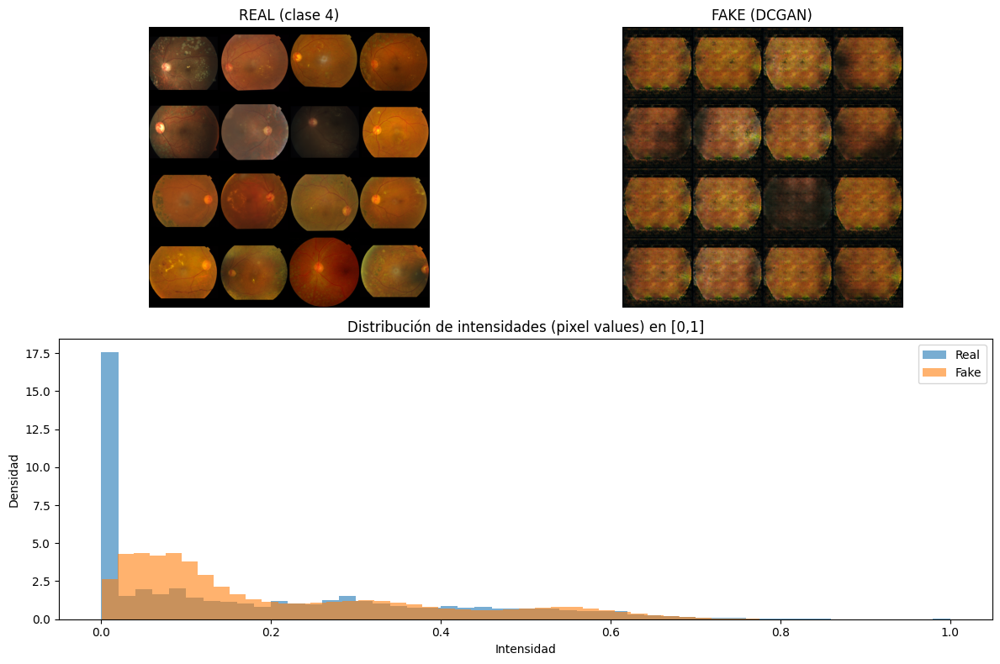

In [43]:
show_real_fake_and_hist_dcgan(dataset_4, loader_4, generator, nz=NZ, n=16, device=device)

# Métricas

## FID (Fréchet Inception Distance)

In [ ]:
# Utilidades base 

def scale_images(images, new_shape_hw=(299, 299)):
    """
    images: np.ndarray (N,H,W,3) float32
    new_shape_hw: (H,W)
    return: np.ndarray (N,299,299,3)
    """
    out = []
    H, W = new_shape_hw
    for img in images:
        out.append(cv2.resize(img, (W, H), interpolation=cv2.INTER_LINEAR))
    return np.asarray(out)



# Calcula FID entre imágenes reales y generadas usando InceptionV3 (Keras)
def calculate_fid(model, images1, images2):
	# calcular las activaciones con el modelo indicado
	act1 = model.predict(images1, verbose=0)
	act2 = model.predict(images2, verbose=0)
	# calcular media y covarianza
	mu1, sigma1 = act1.mean(axis=0), cov(act1, rowvar=False)
	mu2, sigma2 = act2.mean(axis=0), cov(act2, rowvar=False)
	# calcular la suma de las diferencias de las medias al cuadrado
	ssdiff = np.sum((mu1 - mu2)**2.0)
	# calcular la raíz cuadrada del producto de covarianzas
	covmean = sqrtm(sigma1.dot(sigma2))
	# tomar la parte real para los números complejos
	if iscomplexobj(covmean):
		covmean = covmean.real
	# calcular FID
	fid = ssdiff + trace(sigma1 + sigma2 - 2.0 * covmean)
	return fid

In [45]:
# Conversión: PyTorch -> numpy NHWC en [0,255]

# Para usar el FID con el generador PyTorch (salida Tanh en [-1,1]):
# - Convertimos a [0,1]
# - Pasamos a NHWC
# - Escalamos a [0,255]

def torch_to_numpy_01_nhwc(x_torch):
    """
    x_torch: torch.Tensor (N,3,H,W) en [-1,1] o [0,1]
    return: np.ndarray (N,H,W,3) en [0,1]
    """
    x = x_torch.detach().cpu().float()
    # si viene en [-1,1], lo pasamos a [0,1]
    if x.min().item() < 0.0:
        x = (x + 1.0) / 2.0
    x = torch.clamp(x, 0.0, 1.0)
    x = x.permute(0, 2, 3, 1).numpy()  # NHWC
    return x

def prepare_images_for_fid_keras(images_nhwc_01):
    """
    images_nhwc_01: (N,H,W,3) en [0,1]
    """
    images = (images_nhwc_01 * 255.0).astype("float32")   # [0,255]
    images = scale_images(images, (299, 299))            # resize
    images = preprocess_input(images)                    # preprocess Keras InceptionV3
    return images

In [ ]:
# ## Preparar InceptionV3 para FID

model = InceptionV3(include_top=False, pooling='avg', input_shape=(299,299,3))

# ## FID global (reales vs generadas)
#
# - Toma imágenes reales del dataloader (normalizadas con ToTensor+Normalize, típicamente en [-1,1])
# - Genera fake con las mismas condiciones del batch
# - Calcula FID sobre N imágenes

@torch.no_grad()
def collect_real_fake_for_fid_dcgan(generator, dataloader, nz, n_images=500, device="cuda"):
    real_list, fake_list = [], []
    count = 0

    generator.eval()
    for real_imgs, _ in dataloader:
        bs = real_imgs.size(0)
        real_imgs = real_imgs.to(device)

        z = torch.randn(bs, nz, 1, 1, device=device)
        fake = generator(z)  # [-1,1]

        real_list.append(real_imgs.detach().cpu())
        fake_list.append(fake.detach().cpu())

        count += bs
        if count >= n_images:
            break

    real_all = torch.cat(real_list, dim=0)[:n_images]
    fake_all = torch.cat(fake_list, dim=0)[:n_images]
    generator.train()
    return real_all, fake_all

In [47]:
N_FID = 500  
real_t, fake_t = collect_real_fake_for_fid_dcgan(generator, loader_4, nz=NZ, n_images=N_FID, device=device)

real_nhwc_01 = torch_to_numpy_01_nhwc(real_t)
fake_nhwc_01 = torch_to_numpy_01_nhwc(fake_t)

real_proc = prepare_images_for_fid_keras(real_nhwc_01)
fake_proc = prepare_images_for_fid_keras(fake_nhwc_01)

fid_value = calculate_fid(model, real_proc, fake_proc)
print("FID (global): %.3f" % fid_value)

FID (global): 347.321


## Métrica IS (Inception Score)

In [ ]:
# Calcula Inception Score global para imágenes generadas por el DCGAN
def calculate_inception_score(images, n_split=10, eps=1E-16):
	# cargar el modelo inception v3
	model = InceptionV3()
	# convertir a punto flotante
	processed = images.astype('float32')
	# preprocesar imágenes para el modelo inception v3
	processed = preprocess_input(processed)
	# predecir la probabilidad de cada clase
	yhat = model.predict(processed, verbose=0)
	# enumerar particiones de imágenes y predicciones
	scores = list()
	n_part = floor(images.shape[0] / n_split)
	for i in range(n_split):
		# recuperar p(y|x)
		ix_start, ix_end = i * n_part, i * n_part + n_part
		p_yx = yhat[ix_start:ix_end]
		# calcular p(y)
		p_y = expand_dims(p_yx.mean(axis=0), 0)
		# calcular KLD (usando log de las probabilidades)
		kl_d = p_yx * (log(p_yx + eps) - log(p_y + eps))
		# suma sobre clases y promedio sobre imágenes
		sum_kl_d = kl_d.sum(axis=1)
		avg_kl_d = mean(sum_kl_d)
		# revertir el logaritmo y almacenar
		is_score = exp(avg_kl_d)
		scores.append(is_score)
	# promedio sobre particiones
	is_avg, is_std = mean(scores), std(scores)
	return is_avg, is_std

In [ ]:
# Conversión: PyTorch (N,C,H,W) en [-1,1] -> Keras (N,299,299,3) en [0,255]
# - Entrada esperada: batch_fake_torch (tensor PyTorch) en [-1,1], shape (N,3,H,W)
# - Salida: numpy array uint8/float en shape (N,299,299,3) en [0,255]

def torch_to_keras_images_299(fake_torch):
    """
    fake_torch: torch.Tensor (N,3,H,W) en [-1,1]
    return: np.ndarray (N,299,299,3) en [0,255]
    """
    # [-1,1] -> [0,1]
    x = (fake_torch.detach().cpu().float() + 1.0) / 2.0
    x = torch.clamp(x, 0.0, 1.0)

    # resize a 299x299
    x = torch.nn.functional.interpolate(x, size=(299, 299), mode="bilinear", align_corners=False)

    # NCHW -> NHWC
    x = x.permute(0, 2, 3, 1).numpy()

    # [0,1] -> [0,255]
    x = (x * 255.0)
    return x


# IS global 
# Se generan imágenes usando el generador, se convierten a formato Keras y se calcula IS.

def compute_is_global(generator, dataloader, nz, n_images=500, n_split=10, device=device):
    generator.eval()
    batches = []
    count = 0

    with torch.no_grad():
        for real_imgs, _ in dataloader:
            bs = real_imgs.size(0)

            z = torch.randn(bs, nz, 1, 1, device=device)
            fake = generator(z)  # [-1,1]
            batches.append(fake.detach().cpu())

            count += bs
            if count >= n_images:
                break

    fake_all = torch.cat(batches, dim=0)[:n_images].to(device)
    images_keras = torch_to_keras_images_299(fake_all)  # (N,299,299,3) en [0,255]

    if images_keras.shape[0] < n_split:
        raise ValueError(f"No hay suficientes imágenes para n_split={n_split}. N={images_keras.shape[0]}")

    is_avg, is_std = calculate_inception_score(images_keras, n_split=n_split)
    generator.train()
    return is_avg, is_std

In [50]:
IS_avg, IS_std = compute_is_global(generator, loader_4, nz=NZ, n_images=500, n_split=10, device=device)
print(f"IS global: {IS_avg:.3f} ± {IS_std:.3f}")

IS global: 1.208 ± 0.052
